In [57]:
# Package Imports
import pandas as pd
import numpy as np
import plotly.express as px
import json
import plotly.graph_objects as go

from geopy.geocoders import Nominatim
from geojson_rewind import rewind

pd.options.plotting.backend = "plotly"

In [2]:
## Data Importing
# Do not assign to imported variables!
acgr21 = pd.read_table("Data Files/" + "cohort2021.txt", dtype={'CountyCode': str, 'DistrictCode': str, 'SchoolCode': str}, na_values = '*', converters = {'*':0})
schoolZIP = pd.read_table("Data Files/" + "pubschls.txt", dtype={'CDSCode': str}, usecols = ['CDSCode', 'StatusType', 'Zip', 'Street', 'Latitude', 'Longitude'])
ZIPCodeIncome = pd.read_csv("Data Files/" + "ACSST5Y2020.S1903_data_with_overlays_2022-04-24T152354.csv", skiprows=1, converters = {'250,000+':250000}, usecols=["Geographic Area Name", "Estimate!!Median income (dollars)!!HOUSEHOLD INCOME BY RACE AND HISPANIC OR LATINO ORIGIN OF HOUSEHOLDER!!Households"])

In [1]:
np.__version__

NameError: name 'np' is not defined

In [46]:
acgr21[acgr21["DASS"] == 'No ']

,AcademicYear,AggregateLevel,CountyCode,DistrictCode,SchoolCode,CountyName,DistrictName,SchoolName,CharterSchool,DASS,ReportingCategory,CohortStudents,Regular HS Diploma Graduates (Count),Regular HS Diploma Graduates (Rate),Met UC/CSU Grad Req's (Count),Met UC/CSU Grad Req's (Rate),Seal of Biliteracy (Count),Seal of Biliteracy (Rate),Golden State Seal Merit Diploma (Count),Golden State Seal Merit Diploma (Rate,CHSPE Completer (Count),CHSPE Completer (Rate),Adult Ed. HS Diploma (Count),Adult Ed. HS Diploma (Rate),SPED Certificate (Count),SPED Certificate (Rate),GED Completer (Count),GED Completer (Rate),Other Transfer (Count),Other Transfer (Rate),Dropout (Count),Dropout (Rate),Still Enrolled (Count),Still Enrolled (Rate)
19,2020-21,C,01,NaN,NaN,Alameda,NaN,NaN,All,No,GF,7806.0,7301.0,93.5,5055.0,69.2,1491.0,20.4,2568.0,35.2,32.0,0.4,0.0,0.0,56.0,0.7,0.0,0.0,7.0,0.1,311.0,4.0,99.0,1.3
20,2020-21,C,01,NaN,NaN,Alameda,NaN,NaN,All,No,GM,7924.0,7070.0,89.2,4363.0,61.7,859.0,12.1,1967.0,27.8,23.0,0.3,1.0,0.0,97.0,1.2,2.0,0.0,13.0,0.2,571.0,7.2,147.0,1.9
21,2020-21,C,01,NaN,NaN,Alameda,NaN,NaN,All,No,GX,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22,2020-21,C,01,NaN,NaN,Alameda,NaN,NaN,All,No,RA,4311.0,4151.0,96.3,3290.0,79.3,1074.0,25.9,2228.0,53.7,22.0,0.5,0.0,0.0,18.0,0.4,1.0,0.0,2.0,0.0,95.0,2.2,22.0,0.5
23,2020-21,C,01,NaN,NaN,Alameda,NaN,NaN,All,No,RB,1329.0,1175.0,88.4,593.0,50.5,23.0,2.0,106.0,9.0,3.0,0.2,0.0,0.0,27.0,2.0,0.0,0.0,1.0,0.1,88.0,6.6,35.0,2.6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
254914,2020-21,T,00,NaN,NaN,State,NaN,NaN,Yes,No,SF,324.0,217.0,67.0,90.0,41.5,9.0,4.1,21.0,9.7,1.0,0.3,1.0,0.3,3.0,0.9,0.0,0.0,3.0,0.9,69.0,21.3,30.0,9.3
254915,2020-21,T,00,NaN,NaN,State,NaN,NaN,Yes,No,SH,1646.0,1230.0,74.7,488.0,39.7,86.0,7.0,140.0,11.4,3.0,0.2,2.0,0.1,7.0,0.4,0.0,0.0,20.0,1.2,259.0,15.7,125.0,7.6
254916,2020-21,T,00,NaN,NaN,State,NaN,NaN,Yes,No,SM,115.0,95.0,82.6,46.0,48.4,20.0,21.1,14.0,14.7,0.0,0.0,0.0,0.0,1.0,0.9,0.0,0.0,0.0,0.0,9.0,7.8,10.0,8.7
254917,2020-21,T,00,NaN,NaN,State,NaN,NaN,Yes,No,SS,31406.0,27249.0,86.8,16725.0,61.4,3377.0,12.4,5409.0,19.9,84.0,0.3,9.0,0.0,135.0,0.4,17.0,0.1,163.0,0.5,2520.0,8.0,1229.0,3.9


In [18]:
# Extra code to show dataframes
pd.options.display.max_columns = 34
pd.options.display.max_rows = 34
acgr21.shape
acgr21.head()

,AcademicYear,AggregateLevel,CountyCode,DistrictCode,SchoolCode,CountyName,DistrictName,SchoolName,CharterSchool,DASS,ReportingCategory,CohortStudents,Regular HS Diploma Graduates (Count),Regular HS Diploma Graduates (Rate),Met UC/CSU Grad Req's (Count),Met UC/CSU Grad Req's (Rate),Seal of Biliteracy (Count),Seal of Biliteracy (Rate),Golden State Seal Merit Diploma (Count),Golden State Seal Merit Diploma (Rate,CHSPE Completer (Count),CHSPE Completer (Rate),Adult Ed. HS Diploma (Count),Adult Ed. HS Diploma (Rate),SPED Certificate (Count),SPED Certificate (Rate),GED Completer (Count),GED Completer (Rate),Other Transfer (Count),Other Transfer (Rate),Dropout (Count),Dropout (Rate),Still Enrolled (Count),Still Enrolled (Rate)
0,2020-21,C,01,NaN,NaN,Alameda,NaN,NaN,All,All,GF,8683.0,7821.0,90.1,5115.0,65.4,1494.0,19.1,2571.0,32.9,36.0,0.4,0.0,0.0,57.0,0.7,0.0,0.0,15.0,0.2,449.0,5.2,305.0,3.5
1,2020-21,C,01,NaN,NaN,Alameda,NaN,NaN,All,All,GM,9158.0,7678.0,83.8,4416.0,57.5,859.0,11.2,1970.0,25.7,25.0,0.3,3.0,0.0,97.0,1.1,5.0,0.1,29.0,0.3,849.0,9.3,472.0,5.2
2,2020-21,C,01,NaN,NaN,Alameda,NaN,NaN,All,All,GX,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2020-21,C,01,NaN,NaN,Alameda,NaN,NaN,All,All,RA,4439.0,4237.0,95.4,3316.0,78.3,1074.0,25.3,2228.0,52.6,22.0,0.5,0.0,0.0,18.0,0.4,1.0,0.0,2.0,0.0,112.0,2.5,47.0,1.1
4,2020-21,C,01,NaN,NaN,Alameda,NaN,NaN,All,All,RB,1706.0,1362.0,79.8,603.0,44.3,23.0,1.7,107.0,7.9,3.0,0.2,0.0,0.0,27.0,1.6,0.0,0.0,3.0,0.2,172.0,10.1,139.0,8.1


In [61]:
## Data Cleaning and Combining Multiple Data Sources

# Filtering for the following conditions: All schools ("S" and "All" for charter and DASS) with a reporting category of total ("TA") while removing all entries with school code 0000000 or 1
acgr_21 = acgr21.replace('*', int(0)).fillna(0)
schools_acgr21 = acgr_21[(acgr_21["AggregateLevel"] == "S") & (acgr_21["CharterSchool"] == "All") & (acgr_21["DASS"] == "All") & (acgr_21["ReportingCategory"] == "TA") &
                        (acgr_21["SchoolCode"] != "0000000") & (acgr_21["SchoolCode"] != "0000001")]

In [48]:
schools_acgr21.shape

(1704, 34)

In [49]:
# Separate various Series into sub DataFrames to cast type
schools_acgr21_counts = schools_acgr21.loc[:,['(Count' in i for i in schools_acgr21.columns]].astype(int)
schools_acgr21_rates =  schools_acgr21.loc[:,['(Rate' in i for i in schools_acgr21.columns]].astype(float)
cohortStudents = schools_acgr21["CohortStudents"].astype(int)
schoolNames = schools_acgr21["SchoolName"].astype(str)

# Cleaning the school_info entries
schoolZIP_cleaned = schoolZIP[(schoolZIP["Zip"] != "No Data") & (schoolZIP["StatusType"] == "Active")].astype(str) # Removes inactive entries + no Data and casts as string for string method
schoolZIP_cleaned["Zip5"] = schoolZIP_cleaned["Zip"].str[:5] #Cut out +4 in ZIP Code 
#school_info.drop(["Zip"], axis=1,inplace=True)
#school_geodata = school_ZIP[["Street", "Latitude", "Longitude"]]

#school_info = pd.concat([school_ZIP, school_geodata], axis=1)
#school_info.columns = ["CDSCode", "Zip", "Latitude", "Longitude"]

# Some of the school geodata is missing, which involves fixing up by manually checking: 
geolocator = Nominatim(user_agent="sageshadows7@gmail.com")
missingGeoData = schoolZIP_cleaned[(schoolZIP_cleaned["Latitude"]== "No Data")].index
for i in missingGeoData: 
    addy = schoolZIP_cleaned.loc[i]["Street"] + ', ' + str(schoolZIP_cleaned.loc[i]["Zip"])
    location = geolocator.geocode(addy)
    schoolZIP_cleaned.at[i, "Latitude"] = location.latitude
    schoolZIP_cleaned.at[i, "Longitude"] = location.longitude
# We can now cast variable typing and create a new df with the relevant information
school_info = pd.concat([schoolZIP_cleaned[["CDSCode", "Zip5"]].astype('int64'),schoolZIP_cleaned[["Latitude", "Longitude"]].astype('float64')], axis=1)
school_info.columns = ["CDSCode", "Zip", "Latitude", "Longitude"]

# Subsequently, use median income data and sanitize this data. 
ZIPCode_Income = ZIPCodeIncome.replace('250,000+', int(250000)).replace('2,500-', int(2500)).replace('-', int(0)).fillna(0)
ZIPCode_Income.columns = ["Geographic Area Name", "Median Income (USD)"]
ZIPCode_Income["Zip"] = ZIPCode_Income["Geographic Area Name"].str[5:]
ZIPCode_Income.drop(["Geographic Area Name"], axis=1,inplace=True)
ZIPCode_Income = ZIPCode_Income[["Zip", "Median Income (USD)"]].astype('int64')

## Data Joining after Subsequent Cleaning Steps

# Prettyifying up the data frame. First, concatenating the Country + District + School Code for a CDS Code, then creating a connection between school ID and ZIP, then ZIP and Income
CDS_codes = schools_acgr21["CountyCode"]+schools_acgr21["DistrictCode"]+schools_acgr21["SchoolCode"]
CDS_codes = CDS_codes.rename("CDSCode").astype('int64')

schools_geographic = pd.DataFrame({"Copy_Index": pd.Series(CDS_codes.index.values)})
schools_geographic["CDSCode"] = CDS_codes.values

schools_acgr21_geo = pd.merge(schools_geographic,school_info, how='left', indicator=True) # Combines school info with ZIP Code
badEntries = schools_acgr21_geo.loc[schools_acgr21_geo["_merge"] == "left_only"] # After merges, check the school entries that did not get assigned a ZIP code/median income

# Remove the entries that do not have a ZIP code/median income
schools_acgr21_geo.drop(badEntries.index, inplace = True)
schools_acgr21_geo["Zip"] = schools_acgr21_geo["Zip"].astype("int64")
schools_acgr21_counts.drop(badEntries["Copy_Index"], inplace = True)
schools_acgr21_rates.drop(badEntries["Copy_Index"], inplace = True)
cohortStudents.drop(badEntries["Copy_Index"], inplace = True)
schoolNames.drop(badEntries["Copy_Index"], inplace = True)
schools_acgr21_geo.drop(["_merge"], axis=1, inplace=True)

acgr21_organized = pd.merge(schools_acgr21_geo,ZIPCode_Income, how='left') # Combines schools plus ZIP code with income information
acgr21_organized.set_index("Copy_Index", inplace= True)
acgr21_organized.index.name = None
acgr21_organized.fillna(0, inplace=True)

acgr21_cleaned = pd.concat([acgr21_organized,schoolNames,cohortStudents,schools_acgr21_counts,schools_acgr21_rates], axis=1)
# Set zip to str for subsequent geomapping
acgr21_cleaned["Zip"] = acgr21_cleaned["Zip"].astype("str")
# Filter the organized data to come to a final dataset by removing entries with 0s that corresponded to NaN. 
# pd.fillna was called for both income and studentcohort, so set to > 0. 
acgr21_cleaned = acgr21_cleaned[(acgr21_cleaned["CohortStudents"] > 0) & (acgr21_cleaned["Median Income (USD)"] > 0)] #289 schools had NaN entries in either #students or median income that were removed. 

# Additional calculated metrics
acgr21_cleaned["UC/CSU Ready (% of Cohort)"] = (acgr21_cleaned["Met UC/CSU Grad Req's (Count)"]/acgr21_cleaned["CohortStudents"]*100).round(1)

In [50]:
# Locating individual entries identified from SPLOM
acgr21_cleaned.shape

(1583, 30)

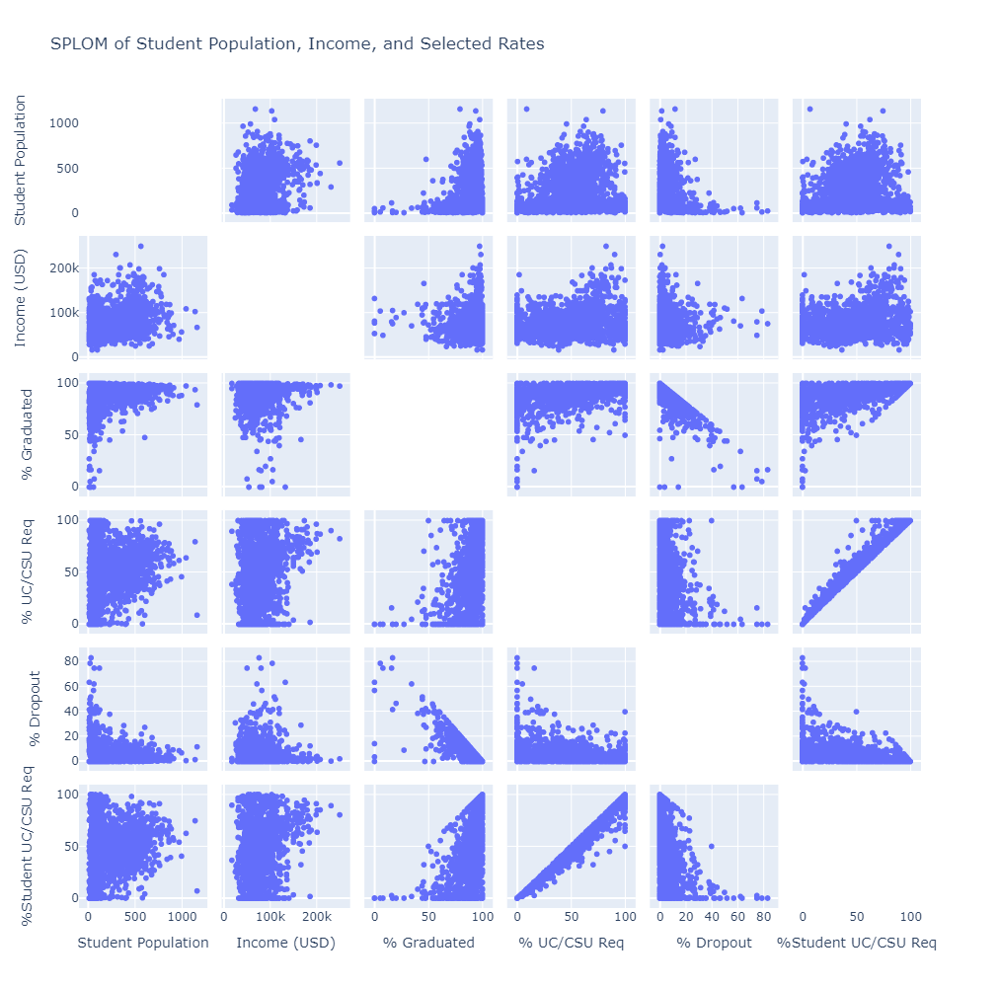

In [51]:
## First pass at looking at data
fig = px.scatter_matrix(acgr21_cleaned, 
        dimensions = ["CohortStudents", "Median Income (USD)", "Regular HS Diploma Graduates (Rate)", "Met UC/CSU Grad Req's (Rate)", "Dropout (Rate)", "UC/CSU Ready (% of Cohort)"],
        title = "SPLOM of Student Population, Income, and Selected Rates", 
        labels = {"CohortStudents": "Student Population", "Median Income (USD)": "Income (USD)", "Regular HS Diploma Graduates (Rate)": "% Graduated", "Met UC/CSU Grad Req's (Rate)": "% UC/CSU Req", "UC/CSU Ready (% of Cohort)": "%Student UC/CSU Req", "Dropout (Rate)": "% Dropout"}, 
        width=1000, height=1000, hover_data = ["CDSCode", acgr21_cleaned.index])
fig.update_traces(diagonal_visible=False)
fig.show()
fig.write_html("SPLOM of Preliminary Data.html", include_plotlyjs='cdn')
# From the scatter_matrix, some outliers are revealed as follows: 
# 1. The largest outlier is the 1 school with 1998 students: Five Keys Independence HS (SF Sheriff's) (#208337) which will be removed. 
# 2. Two additional outliers can be seen in New Opportunities Charter (#108062) and Family First Charter (#107995) which are both for adult continuing education. 

In [54]:
acgr21_cleaned_filtered.head(5)

,CDSCode,Zip,Latitude,Longitude,Median Income (USD),SchoolName,CohortStudents,Regular HS Diploma Graduates (Count),Met UC/CSU Grad Req's (Count),Seal of Biliteracy (Count),Golden State Seal Merit Diploma (Count),CHSPE Completer (Count),Adult Ed. HS Diploma (Count),SPED Certificate (Count),GED Completer (Count),Other Transfer (Count),Dropout (Count),Still Enrolled (Count),Regular HS Diploma Graduates (Rate),Met UC/CSU Grad Req's (Rate),Seal of Biliteracy (Rate),Golden State Seal Merit Diploma (Rate,CHSPE Completer (Rate),Adult Ed. HS Diploma (Rate),SPED Certificate (Rate),GED Completer (Rate),Other Transfer (Rate),Dropout (Rate),Still Enrolled (Rate),UC/CSU Ready (% of Cohort)
66236,1100170112607,94612,37.804520,-122.26815,59773.0,Envision Academy for Arts & Technology,94,85,85,0,19,0,0,0,0,0,9,0,90.4,100.0,0.0,22.4,0.0,0.0,0.0,0.0,0.0,9.6,0.0,90.4
66434,1100170136101,94587,37.603623,-122.02530,120772.0,Connecting Waters Charter - East Bay,19,15,5,0,9,1,0,0,0,0,3,0,78.9,33.3,0.0,60.0,5.3,0.0,0.0,0.0,0.0,15.8,0.0,26.3
66562,1316090131755,94536,37.562576,-121.96563,132568.0,California School for the Blind,11,0,0,0,0,0,0,4,0,0,7,0,0.0,0.0,0.0,0.0,0.0,0.0,36.4,0.0,0.0,63.6,0.0,0.0
66624,1316170131763,94538,37.558956,-121.96551,119206.0,California School for the Deaf-Fremont,38,24,0,8,7,0,0,2,0,0,1,11,63.2,0.0,33.3,29.2,0.0,0.0,5.3,0.0,0.0,2.6,28.9,0.0
66750,1611190106401,94501,37.780753,-122.27930,96014.0,Alameda Science and Technology Institute,43,43,41,1,22,0,0,0,0,0,0,0,100.0,95.3,2.3,51.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,95.3


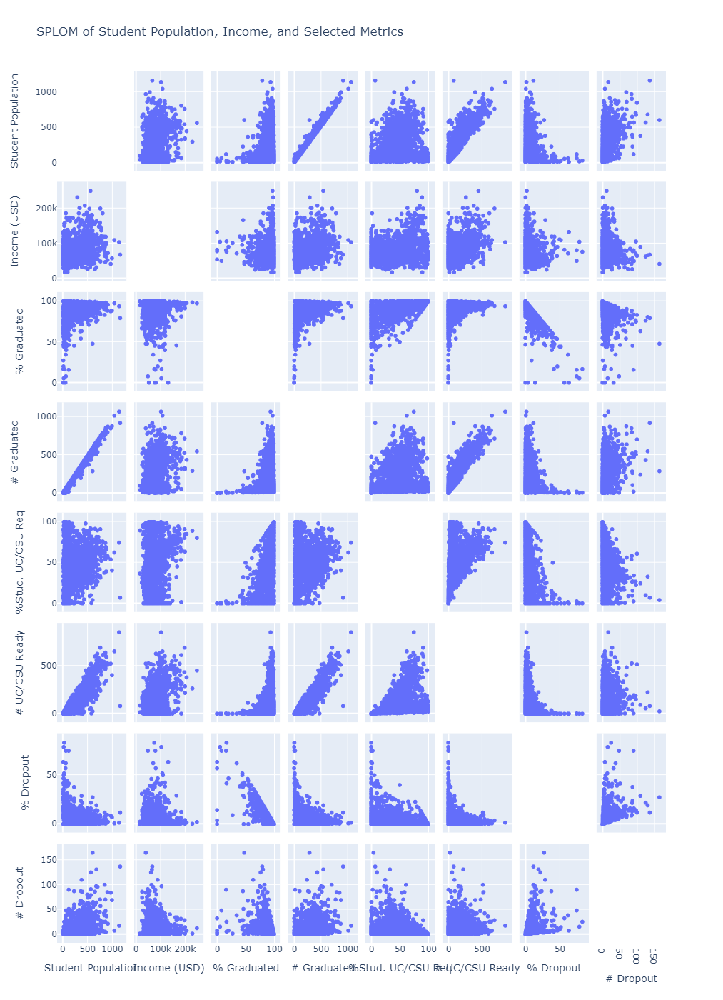

In [53]:
# Additional filtering after looking at SPLOM
acgr21_cleaned_filtered = acgr21_cleaned#.drop([107995, 108062, 208337])
fig2 = px.scatter_matrix(acgr21_cleaned_filtered, 
        dimensions = ["CohortStudents", "Median Income (USD)", "Regular HS Diploma Graduates (Rate)", "Regular HS Diploma Graduates (Count)", "UC/CSU Ready (% of Cohort)", "Met UC/CSU Grad Req's (Count)", "Dropout (Rate)", "Dropout (Count)"],
        title = "SPLOM of Student Population, Income, and Selected Metrics", 
        labels = {"CohortStudents": "Student Population", 
                  "Median Income (USD)": "Income (USD)", 
                  "Regular HS Diploma Graduates (Rate)": "% Graduated",
                  "Regular HS Diploma Graduates (Count)": "# Graduated", 
                  "Met UC/CSU Grad Req's (Count)": "# UC/CSU Ready", 
                  "UC/CSU Ready (% of Cohort)": "%Stud. UC/CSU Req", 
                  "Dropout (Rate)": "% Dropout", 
                  "Dropout (Count)": "# Dropout"}, 
        width=1400, height=1400, hover_data = ["CDSCode", acgr21_cleaned_filtered.index])
fig2.update_traces(diagonal_visible=False)
fig2.show()
fig2.write_html("SPLOM of Student Population, Income, and Selected Metrics.html", include_plotlyjs='cdn')

In [55]:
## Geospatial Figures Data Imports (Takes a while, do not run too much)
# Original data from https://github.com/OpenDataDE/State-zip-code-GeoJSON and simplified with https://mapshaper.org/ down to .5%
with open("Data Files/" + "ca_california_zip_codes_geo.min.json", "r") as response: # Original geoJSON data
    zipcodes_complex = json.load(response)
with open("Data Files/" +"ca_california_zip_codes_geo_simplified.min.json", "r") as response: # Simplified from mapshaper
    zipcodes = json.load(response)
zipcodes = rewind(zipcodes, rfc7946=False)

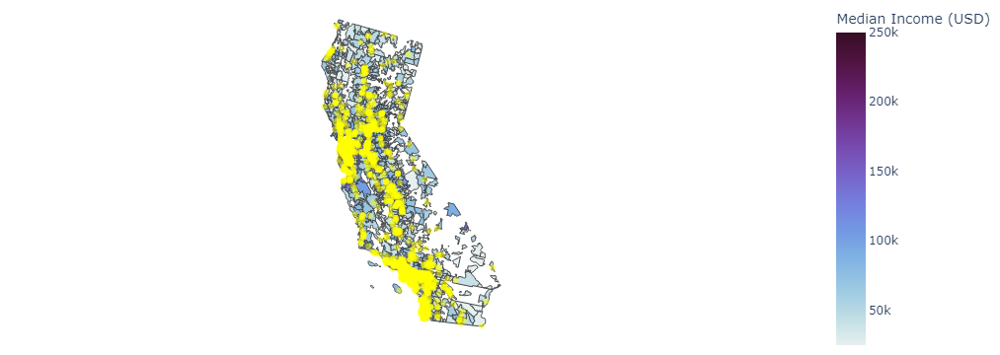

In [58]:
ZIPCode_Income_Map = ZIPCode_Income
ZIPCode_Income_Map["Zip"] = ZIPCode_Income_Map["Zip"].astype("str")
CA_map = px.choropleth(ZIPCode_Income_Map, 
        geojson=zipcodes,
        locations='Zip', 
        featureidkey = "properties.ZCTA5CE10", 
        color='Median Income (USD)', 
        scope='usa',
        range_color=(25000, 250000),
        color_continuous_scale="Dense")
CA_map.update_geos(fitbounds="locations", visible=False)
CA_map.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
CA_map.write_html("Map of CA Household Incomes by ZCTAs.html", include_plotlyjs='cdn')

schools_of_interest = acgr21_cleaned_filtered
school_map = px.scatter_geo(schools_of_interest, 
                            lat="Latitude", 
                            lon="Longitude", 
                            scope='usa',
                            #size="Dropout (Rate)", size_max=10,
                            center= {'lat': 36.7783, 'lon': -119.4179},
                            opacity=0.5,
                            #color="Regular HS Diploma Graduates (Rate)",
                            hover_data={"Latitude": False, 
                                        "Longitude": False, 
                                        "CohortStudents": True, 
                                        "Regular HS Diploma Graduates (Count)": True,
                                        "Met UC/CSU Grad Req's (Count)": True, 
                                        "Regular HS Diploma Graduates (Rate)": True, 
                                        "UC/CSU Ready (% of Cohort)": True,
                                        "SchoolName": True},
                            labels = {"CohortStudents": "Students", 
                                      "Regular HS Diploma Graduates (Count)": "Graduates",
                                      "Met UC/CSU Grad Req's (Count)": "UC/CSU Qualified Graduates", 
                                      "Regular HS Diploma Graduates (Rate)": "Graduates [% of Students]", 
                                      "UC/CSU Ready (% of Cohort)": "%Stud. UC/CSU Req", 
                                      "SchoolName": "School Name"},
                            hover_name=schools_of_interest.index)
school_map.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
school_map.update_traces(marker_color="Yellow")
school_map.write_html("Map of CA High Schools.html", include_plotlyjs='cdn')

CA_map_overlay = go.Figure(CA_map)
CA_map_overlay.add_trace(school_map.data[0])
#CA_map_overlay.update_layout(title_text="Map of CA High Schools with ZTCA Income", title_x=0.40,title_y=.995)
#CA_map_overlay.write_html("Map of CA High Schools with ZTCA Income.html", include_plotlyjs='cdn')
CA_map_overlay.show()

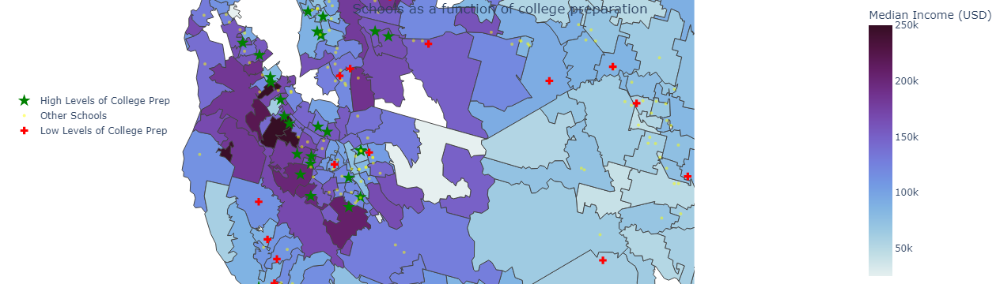

In [59]:
CA_map_overlay2 = go.Figure(CA_map)
schools_college_prep = acgr21_cleaned_filtered[(acgr21_cleaned_filtered["UC/CSU Ready (% of Cohort)"] > 80)]
school_map_college_prep = px.scatter_geo(schools_college_prep, 
                            lat="Latitude", 
                            lon="Longitude", 
                            scope='usa',
                            #size="Met UC/CSU Grad Req's (Count)", size_max=10,
                            center= {'lat': 36.7783, 'lon': -119.4179},
                            #color="Regular HS Diploma Graduates (Rate)",
                            opacity=1,
                            hover_data={"Latitude": False, 
                                        "Longitude": False, 
                                        "CohortStudents": True, 
                                        "Regular HS Diploma Graduates (Count)": True,
                                        "Met UC/CSU Grad Req's (Count)": True, 
                                        "Regular HS Diploma Graduates (Rate)": True, 
                                        "UC/CSU Ready (% of Cohort)": True,
                                        "SchoolName": True},
                            labels = {"CohortStudents": "Students", 
                                      "Regular HS Diploma Graduates (Count)": "Graduates",
                                      "Met UC/CSU Grad Req's (Count)": "UC/CSU Qualified Graduates", 
                                      "Regular HS Diploma Graduates (Rate)": "Graduates [% of Students]", 
                                      "UC/CSU Ready (% of Cohort)": "%Stud. UC/CSU Req", 
                                      "SchoolName": "School Name"},
                            hover_name=schools_college_prep.index)
school_map_college_prep.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
school_map_college_prep.update_traces(marker_symbol="star", marker_color="Green", marker_size=12, name="High Levels of College Prep", showlegend=True)

# Filters for schools that have reported UC/CSU Grad Requirements (Count > 0) and have a low UC/CSU Req/Cohort Student Ratio (< 20%) OR have a very low graduation rate (<35%) with no UC/CSU Grad Reports
schools_low_college_prep = pd.concat([acgr21_cleaned_filtered[(acgr21_cleaned_filtered["UC/CSU Ready (% of Cohort)"] < 20) & 
                                           (acgr21_cleaned_filtered["Met UC/CSU Grad Req's (Count)"] > 0)],
                                      acgr21_cleaned_filtered[(acgr21_cleaned_filtered["Regular HS Diploma Graduates (Rate)"] < 25) & 
                                           (acgr21_cleaned_filtered["Met UC/CSU Grad Req's (Count)"] == 0)]])
school_map_low_college_prep = px.scatter_geo(schools_low_college_prep, 
                            lat="Latitude", 
                            lon="Longitude", 
                            scope='usa',
                            #size="Met UC/CSU Grad Req's (Count)", size_max=10,
                            center= {'lat': 36.7783, 'lon': -119.4179},
                            #color="Regular HS Diploma Graduates (Rate)",
                            opacity=1,
                            hover_data={"Latitude": False, 
                                        "Longitude": False, 
                                        "CohortStudents": True, 
                                        "Regular HS Diploma Graduates (Count)": True,
                                        "Met UC/CSU Grad Req's (Count)": True, 
                                        "Regular HS Diploma Graduates (Rate)": True, 
                                        "UC/CSU Ready (% of Cohort)": True,
                                        "SchoolName": True},
                            labels = {"CohortStudents": "Students", 
                                      "Regular HS Diploma Graduates (Count)": "Graduates",
                                      "Met UC/CSU Grad Req's (Count)": "UC/CSU Qualified Graduates", 
                                      "Regular HS Diploma Graduates (Rate)": "Graduates [% of Students]", 
                                      "UC/CSU Ready (% of Cohort)": "%Stud. UC/CSU Req", 
                                      "SchoolName": "School Name"},
                            hover_name=schools_low_college_prep.index)
school_map_low_college_prep.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
school_map_low_college_prep.update_traces(marker_symbol="cross", marker_color="Red", marker_size=8, name="Low Levels of College Prep", showlegend=True)


# Plot the rest of the schools
schools_remainder = acgr21_cleaned_filtered[~acgr21_cleaned_filtered.isin(pd.concat([schools_college_prep, schools_low_college_prep]))].dropna(how = 'all')
school_map_remainder = px.scatter_geo(schools_remainder, 
                            lat="Latitude", 
                            lon="Longitude", 
                            scope='usa',
                            #size="Met UC/CSU Grad Req's (Count)", size_max=10,
                            center= {'lat': 36.7783, 'lon': -119.4179},
                            #color="Regular HS Diploma Graduates (Rate)",
                            opacity=0.5,
                            hover_data={"Latitude": False, 
                                        "Longitude": False, 
                                        "CohortStudents": True, 
                                        "Regular HS Diploma Graduates (Count)": True,
                                        "Met UC/CSU Grad Req's (Count)": True, 
                                        "Regular HS Diploma Graduates (Rate)": True, 
                                        "UC/CSU Ready (% of Cohort)": True,
                                        "SchoolName": True},
                            labels = {"CohortStudents": "Students", 
                                      "Regular HS Diploma Graduates (Count)": "Graduates",
                                      "Met UC/CSU Grad Req's (Count)": "UC/CSU Qualified Graduates", 
                                      "Regular HS Diploma Graduates (Rate)": "Graduates [% of Students]", 
                                      "UC/CSU Ready (% of Cohort)": "%Stud. UC/CSU Req", 
                                      "SchoolName": "School Name"},
                            hover_name=schools_remainder.index)
school_map_remainder.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
school_map_remainder.update_traces(marker_symbol="circle", marker_color="Yellow", marker_size=4, name="Other Schools", showlegend=True)

CA_map_overlay2.add_trace(school_map_college_prep.data[0])
CA_map_overlay2.add_trace(school_map_remainder.data[0])
CA_map_overlay2.add_trace(school_map_low_college_prep.data[0])

CA_map_overlay2.update_layout(title={'y':0.985,'x':0.5,'xanchor': 'center','yanchor': 'top', 'text':"Schools as a function of college preparation"}, legend={"yanchor":"bottom","y":0.5,"xanchor":"left","x":0.01})
CA_map_overlay2.show()
CA_map_overlay2.write_html("Schools as College Prep.html", include_plotlyjs='cdn')

In [60]:
# Check to see if all schools are represented.

print("The number of excellent college preparatory schools is: {}".format(schools_college_prep.shape[0]))
print("The number of low college preparatory schools is: {}".format(schools_low_college_prep.shape[0]))
print("The number of remaining schools is: {}".format(schools_remainder.shape[0]))
print("The number of total schools in the original cleaned dataset is: {}".format(acgr21_cleaned_filtered.shape[0]))
print("Does this add up? {}".format(schools_remainder.shape[0]+schools_college_prep.shape[0]+schools_low_college_prep.shape[0] == acgr21_cleaned_filtered.shape[0]))

The number of excellent college preparatory schools is: 182
The number of low college preparatory schools is: 194
The number of remaining schools is: 1207
The number of total schools in the original cleaned dataset is: 1583
Does this add up? True
